# Pro Cam Scan

## Setup
Notes for setting up on a GCE instance (Ubuntu 16.04). This notebook wont run with the free colab instance

### Connect to GCE instance 

```ssh -i $HOME/.ssh/google_compute_engine jongejan@<IP> -L 8888:localhost:8888 ```

### Setup dependencies:
```
wget https://repo.anaconda.com/archive/Anaconda3-5.2.0-Linux-x86_64.sh
bash Anaconda3-5.2.0-Linux-x86_64.sh
pip install jupyter_http_over_ws
jupyter serverextension enable --py jupyter_http_over_ws
gcloud init
```

### Start
```jupyter notebook   --NotebookApp.allow_origin='https://colab.research.google.com'   --no-browser  --port=8888```



### Upload data:
```gsutil -m rsync -r SharedData/ gs://lightleaks/todaysart/```

Interesting things I noticed:
- Color is a subtle indicator of edge reflections.
- It should be possible to know that the gray area between white and black belongs to both white and black.
- Highpass is only helpful for calculating the confidence, not useful for building the map.

In [1]:
#@title Settings { run: "auto" }

# SETTINGS
proj_width = 5760 #@param {type:"integer"}
proj_height = 1080 #@param {type:"integer"}

bucket = 'lightleaks'
bucket_folder = "todaysart" #@param ["music_center", "todaysart"] {allow-input: true}

blur_distance = 301
processing_name = 'promap-'+str(blur_distance)

LOCAL = True

if LOCAL:
    data_dir = '/home/jovyan/SharedData'
else:
    data_dir = '/tmp/data/'+bucket_folder

In [2]:
# !sudo apt-get -qq install -y libsm6 libxext6 && pip install -q -U opencv-python
# !sudo apt-get install -y libturbojpeg  libxrender-dev
# !pip install jpeg4py msgpack numpy-indexed

# !rm -rf utils
# !git clone https://github.com/kylemcdonald/python-utils utils
import sys

# Utils is added at this path in docker image:
sys.path.append('/home/jovyan/')

import cv2
from utils.imutil import *
from utils.progress import *
# from utils.show_array import *
from matplotlib import pyplot as plt
from itertools import product
import glob 
from scipy import ndimage
from multiprocessing import Pool, cpu_count
from numba import jit


# !pip install mpld3
# import matplotlib.pyplot as plt, mpld3
%matplotlib inline

# mpld3.


In [3]:

def sync_data():
    if not LOCAL:
        !mkdir -p {data_dir}
        !gsutil -m rsync -r -d 'gs://{bucket}/{bucket_folder}' /tmp/data/{bucket_folder}

sync_data()

print("Scans:")
!ls -d {data_dir}/scan-*/

Scans:
/home/jovyan/SharedData/scan-1848/  /home/jovyan/SharedData/scan-2021/
/home/jovyan/SharedData/scan-1851/  /home/jovyan/SharedData/scan-2025/
/home/jovyan/SharedData/scan-1854/  /home/jovyan/SharedData/scan-2030/
/home/jovyan/SharedData/scan-1858/  /home/jovyan/SharedData/scan-2041/
/home/jovyan/SharedData/scan-1900/  /home/jovyan/SharedData/scan-2046/
/home/jovyan/SharedData/scan-2008/  /home/jovyan/SharedData/scan-2326/
/home/jovyan/SharedData/scan-2013/  /home/jovyan/SharedData/scan-2344/
/home/jovyan/SharedData/scan-2017/


## Image loading

In [4]:
# !ls -d {data_dir}/scan-*/
# _scan_name = 'scan-1954' #@param  {type: "string"}
# !mkdir -p /tmp/scan/
# !gsutil -m -q cp -r 'gs://{bucket}/{scan_name}' /tmp/scan/

def job(fn):
#     print(fn)
    # faster to do conversion to gray here (in parallel) rather than later
    data = imread(fn).mean(axis=2)
    
    lowpass = cv2.GaussianBlur(data,(blur_distance,blur_distance),0)
#     lowpass = cv2.GaussianBlur(data,(301,301),0)
    #     lowpass = ndimage.gaussian_filter(data, 300)
    gauss_highpass = data - lowpass
    gauss_highpass = gauss_highpass / 2
    gauss_highpass = gauss_highpass + 128
    gauss_highpass = np.clip(gauss_highpass, 0, 255)
    gauss_highpass = np.abs(gauss_highpass)
#     print(gauss_highpass.min(), gauss_highpass.max())
    return gauss_highpass.astype(np.uint8)

def load_scan(__scan_name):
    global scan_name, cam_mask_image, normal_horizontal, inverse_horizontal, normal_vertical, inverse_vertical, reference_image, min_image
    scan_name = __scan_name
    count_vertical_files_normal = len(glob.glob1(os.path.join(data_dir,scan_name,'cameraImages/vertical/normal'),"*.jpg"))
    count_vertical_files_inverse = len(glob.glob1(os.path.join(data_dir,scan_name,'cameraImages/vertical/inverse'),"*.jpg"))
    count_horizontal_files_normal = len(glob.glob1(os.path.join(data_dir,scan_name,'cameraImages/horizontal/normal'),"*.jpg"))
    count_horizontal_files_inverse = len(glob.glob1(os.path.join(data_dir,scan_name,'cameraImages/horizontal/inverse'),"*.jpg"))
    assert count_vertical_files_normal > 0
    assert count_vertical_files_normal == count_vertical_files_inverse
    assert count_horizontal_files_normal == count_horizontal_files_inverse


    # cam_mask_image = 
    try:
        cam_mask_image = imread(os.path.join(data_dir,scan_name,"mask.png"))
        cam_mask_image = cv2.cvtColor(cam_mask_image, cv2.COLOR_BGR2GRAY)
#         if len(cam_mask_image.shape) == 3:
#             cam_mask_image = cam_mask_image.mean(axis=2)
    except:
        cam_mask_image = None
        print("No mask loadeed")

    filenames = []
    descriptions = []
    for direction, n in (('vertical', count_vertical_files_normal), ('horizontal', count_horizontal_files_normal)):
        for parity in ('normal', 'inverse'):
#     direction = 'vertical'
#     parity = 'normal'
#     n = count_vertical_files_normal
            cur = [(direction, parity, i) for i in range(n)]
            descriptions.extend(cur)
            filenames.extend([os.path.join(data_dir,scan_name,'cameraImages/{}/{}/{}.jpg'.format(*e)) for e in cur])

#   print(count_vertical_files_normal, filenames)
#   images = progress_parallel(job, filenames)
    print("List images, loading and pre-processing now")
    with Pool(processes=cpu_count()) as pool:
        images = pool.map(job, filenames)
    print("Pre-processing finished")
    # Load images in right buckets

    normal_horizontal = np.asarray([i for i,d in zip(images, descriptions) if d[0] == 'horizontal' and d[1] == 'normal'])
    inverse_horizontal = np.asarray([i for i,d in zip(images, descriptions) if d[0] == 'horizontal' and d[1] == 'inverse'])
    normal_vertical = np.asarray([i for i,d in zip(images, descriptions) if d[0] == 'vertical' and d[1] == 'normal'])
    inverse_vertical = np.asarray([i for i,d in zip(images, descriptions) if d[0] == 'vertical' and d[1] == 'inverse'])

    images_raw = np.asarray([i for i in images])
    min_image = np.amin(images_raw, axis=0)
    reference_image = cv2.equalizeHist(min_image)

    print("Horizontal count: %d" % len(normal_horizontal))
    print("Vertical count: %d" % len(normal_vertical))

# load_scan(_scan_name)
# imshow(reference_image)

In [5]:
# imshow(normal_horizontal[4])
# def job(fn):
# #     print(fn)
#     # faster to do conversion to gray here (in parallel) rather than later
#     data = imread(fn).mean(axis=2)
#     lowpass = cv2.GaussianBlur(data,(301,301),0)
# #     lowpass = ndimage.gaussian_filter(data, 31)
#     gauss_highpass = data - lowpass
#     gauss_highpass = gauss_highpass / 2
#     gauss_highpass = gauss_highpass + 128
#     gauss_highpass = np.clip(gauss_highpass, 0, 255)
# #     gauss_highpass = np.abs(gauss_highpass)
#     print(gauss_highpass.min(), gauss_highpass.max())
#     return gauss_highpass.astype(np.uint8)

# imshow(job(os.path.join(data_dir,scan_name,'cameraImages/horizontal/inverse/3.jpg')), fmt='jpg')

In [6]:
def calculate_difference():
    global diff_code_horizontal, diff_code_vertical, confidence_horizontal, confidence_vertical
    global confidence
    # Calculate differeence
    diff_code_horizontal = normal_horizontal.astype(np.float32) - inverse_horizontal.astype(np.float32)
    diff_code_vertical = normal_vertical.astype(np.float32) - inverse_vertical.astype(np.float32)

    confidence_horizontal = np.sum(np.abs(diff_code_horizontal), axis=0) // len(diff_code_vertical)
    confidence_vertical = np.sum(np.abs(diff_code_vertical), axis=0) // len(diff_code_horizontal)

    # Another approach: Minimal confidence score (except highest frquency)
    # confidence_horizontal = np.min(np.abs(diff_code_horizontal[5:6]), axis=0) 
    # confidence_vertical = np.min(np.abs(diff_code_vertical[5:6]), axis=0) 

    confidence_vertical /=  256.0
    confidence_horizontal /=  256.0

    confidence = np.mean((confidence_horizontal, confidence_vertical), axis=0)

    confidence[cam_mask_image == 0] = 0
    confidence_raw = confidence

    # std = (np.std(np.abs(diff_code_horizontal), axis=0) + np.std(np.abs(diff_code_vertical), axis=0)) / 512
    # std = (np.std(np.abs(diff_code_horizontal), axis=0) ) / 256
    # print("Std: ",std.max())
    # confidence = std * confidence


# calculate_difference()
# print("Max confidence:", confidence.max())
# print("Max confidence vertical:", confidence_vertical.max(), "mean", confidence_vertical.mean())
# print("Max confidence horizontal:", confidence_horizontal.max(), "mean", confidence_horizontal.mean())
# print(confidence.shape)


## Binary packing

In [7]:
# Binary packing
def pack_raw(channels, dtype=np.uint16):
    packed = (channels > 0).astype(dtype)
    n = len(packed)
    for i in range(n):
        packed[i] <<= n - i - 1
    return packed.sum(axis=0).astype(dtype)

def gray_to_binary(packed, n, dtype=np.uint16):
    codes = 1 << n
    lut = np.zeros(codes)
    for binary in range(codes):
        gray = (binary >> 1) ^ binary
        lut[gray] = binary
    return lut[packed].astype(dtype)

def pack_binary(channels, dtype=np.uint16):
    return gray_to_binary(pack_raw(channels, dtype), len(channels), dtype)
        

In [8]:
def run_pack():
    global packed_horizontal, packed_vertical, packed
    packed_horizontal = pack_binary(diff_code_horizontal)
    packed_vertical = pack_binary(diff_code_vertical)

    # packed_vertical[cam_mask_image == 0] = 0
    # packed_horizontal[cam_mask_image == 0] = 0

    # packed = np.dstack((packed_vertical, packed_horizontal, np.zeros_like(packed_horizontal)))
    packed = np.dstack((packed_vertical, packed_horizontal))
    packed.shape
# run_pack()

## Build pro map

In [9]:
# Build Pro Map

def add_channel(x):
    return np.pad(x, pad_width=((0,0),(0,0),(0,1)), mode='constant', constant_values=0)

@jit('uint16(uint16[:], uint16[:], uint16[:], int64, int64)')
def build_pro_map(packed_vertical, packed_horizontal, confidence, w, h):
    packed_vertical = np.minimum(packed_vertical, w-1)
    packed_horizontal = np.minimum(packed_horizontal, h-1)
    cam_map = np.dstack((packed_horizontal, packed_vertical))

    pro_map = np.zeros((h,w,2), dtype=np.uint16)
    pro_confidence = np.zeros((h,w), dtype=np.float32)
    
    for i in range(cam_map.shape[0]):
        for j in range(cam_map.shape[1]):
            idx = cam_map[i,j]
            pconf = confidence[i,j]
            # (j, i) should probably be swapped, but
            # this is how it was done in c++
            if pconf > 0 and pconf > pro_confidence[idx[0], idx[1]]:
                pro_map[idx[0], idx[1]] = (j, i)
                pro_confidence[idx[0], idx[1]] = pconf
    return (add_channel(pro_map), pro_confidence)


In [10]:
def run_build_promap():
  global pro_map, pro_confidence
  (pro_map, pro_confidence) = build_pro_map(packed_vertical, packed_horizontal, confidence, proj_width, proj_height)

# run_build_promap()
# print(pro_confidence.shape)

In [11]:
def render_result():
    mc = pro_confidence.max()
    mm = pro_map.max(axis=(0,1))
    mm[2] = 1

    #   print(mc)

    im = (256, 256, 256) * pro_map / mm
    imshow(pro_confidence * 256 / mc, zoom=.2, fmt='jpg')
#     imshow(im, zoom=0.2, fmt='jpg')
    imshow(im * pro_confidence[:,:,np.newaxis] * (1./mc), zoom=0.3, fmt='jpg')
    imshow(reference_image, zoom=0.1, fmt='jpg')

#     conf_debug = reference_image * confidence 
    conf_debug = confidence 
    conf_debug = conf_debug.astype(np.uint8)
    conf_debug = cv2.equalizeHist(conf_debug)
    imshow(conf_debug, zoom=0.1, fmt='jpg')
  
render_result()


NameError: name 'pro_confidence' is not defined

## Store results

In [12]:
def outPath(folder):
    return '../SharedData/'+folder+'/'+processing_name+'/'

def exists(folder):
    return os.path.exists(outPath(folder))


def store_results(folder):
    out_path = outPath(folder)
    if not os.path.exists(out_path):
        os.makedirs(out_path)
    
    print('storing in '+out_path)
    #   print(pro_confidence.dtype)
    # Store results
    imwrite(out_path+'proMap.png', pro_map)
    imwrite(out_path+'proConfidence.exr', pro_confidence)
    imwrite(out_path+'camConfidence.exr', confidence)
    imwrite(out_path+'referenceImage.jpg', reference_image)

    imwrite(out_path+'minImage.png', min_image)


    #   im = np.dstack((packed, np.zeros_like(packed_horizontal))) 
    #   imwrite('camBinary.exr', im)
    np.save(out_path+'camBinary.npy', packed)
    
#     if not LOCAL:
#         !gsutil cp ../SharedData/proMap-python.png gs://{bucket}/{bucket_folder}/{scan_name}/
#         !gsutil cp ../SharedData/proConfidence-python.exr gs://{bucket}/{bucket_folder}/{scan_name}/
#         !gsutil cp ../SharedData/camConfidence-python.exr gs://{bucket}/{bucket_folder}/{scan_name}/
#         !gsutil cp ../SharedData/camBinary-python.npy gs://{bucket}/{bucket_folder}/{scan_name}/
#         !gsutil cp ../SharedData/referenceImage.jpg gs://{bucket}/{bucket_folder}/{scan_name}/
#         !gsutil cp ../SharedData/minImage.png gs://{bucket}/{bucket_folder}/{scan_name}/
    
# store_results()

## Run it all!

['scan-1848', 'scan-1851', 'scan-1854', 'scan-1858']
['scan-1848', 'scan-1851', 'scan-1854', 'scan-1858']
load scan-1848
List images, loading and pre-processing now
Pre-processing finished
Horizontal count: 11
Vertical count: 13
CPU times: user 1.93 s, sys: 4.04 s, total: 5.97 s
Wall time: 1min 47s
calculate diff
run pack
build promap


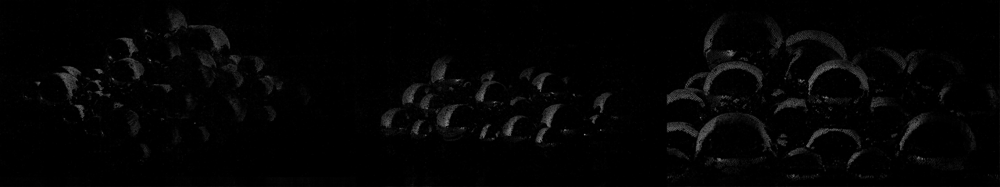

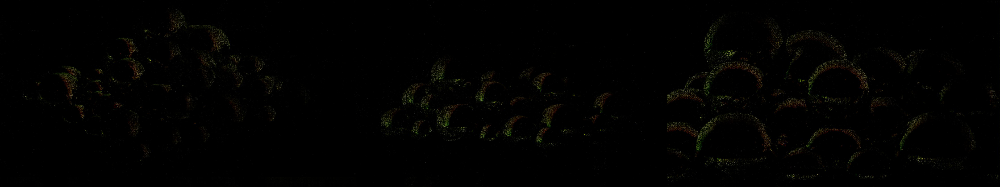

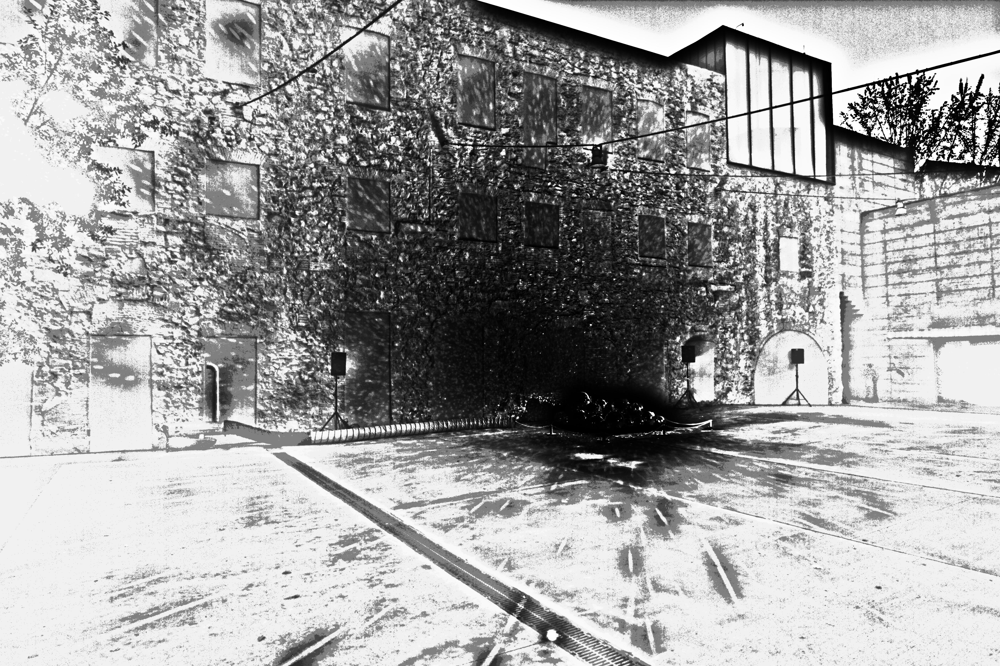

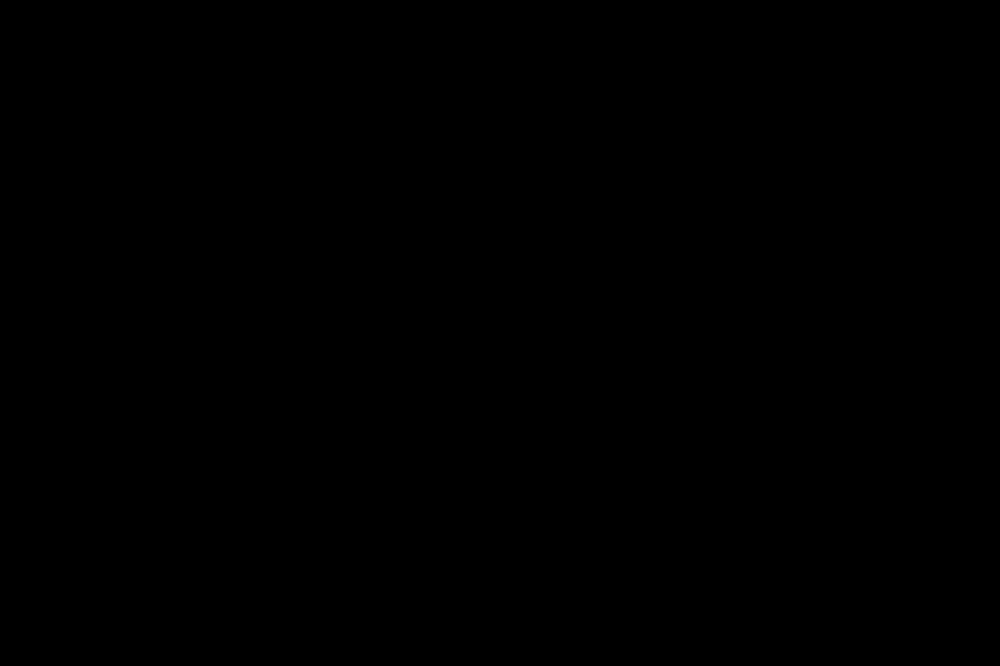

CPU times: user 1.09 s, sys: 270 ms, total: 1.36 s
Wall time: 1.33 s
storing in ../SharedData/scan-1848/promap-301/
load scan-1851
List images, loading and pre-processing now
Pre-processing finished
Horizontal count: 11
Vertical count: 13
CPU times: user 1.94 s, sys: 4.49 s, total: 6.43 s
Wall time: 1min 48s
calculate diff
run pack
build promap


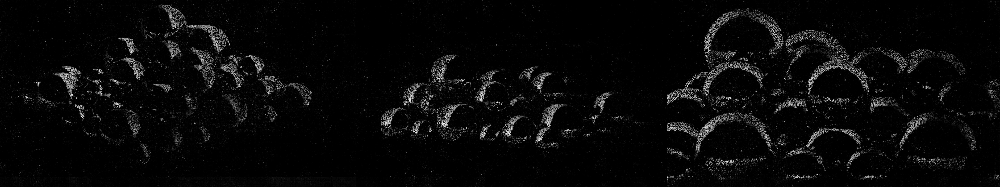

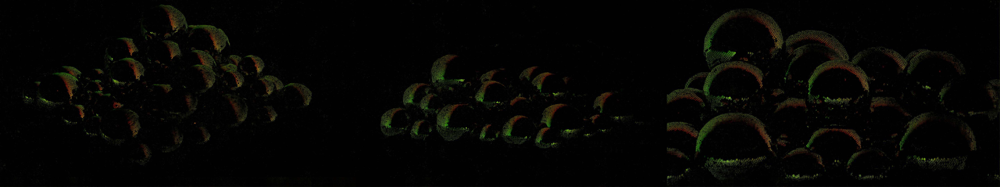

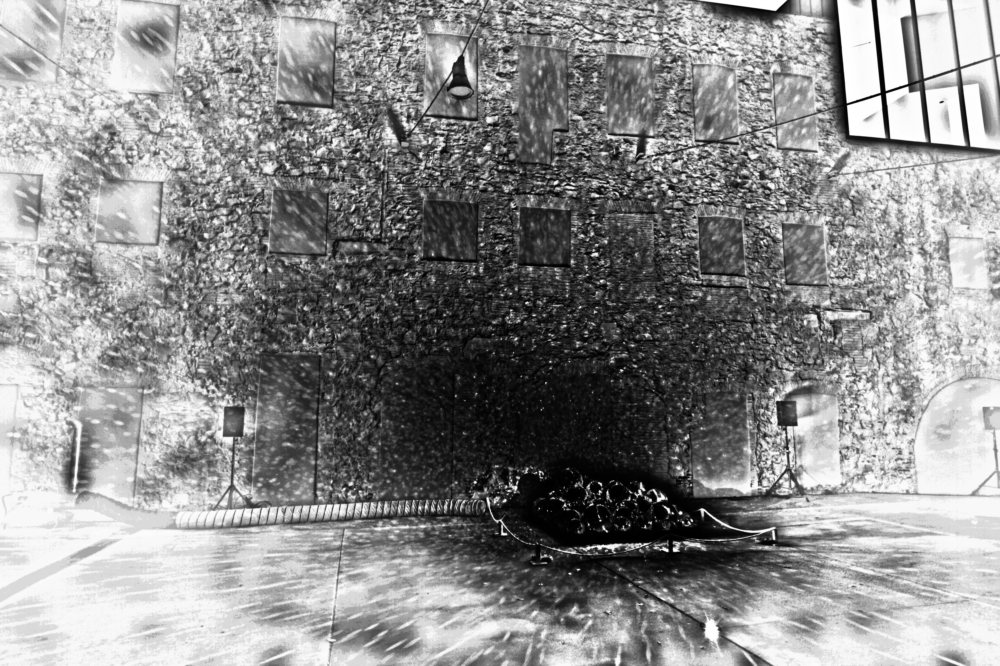

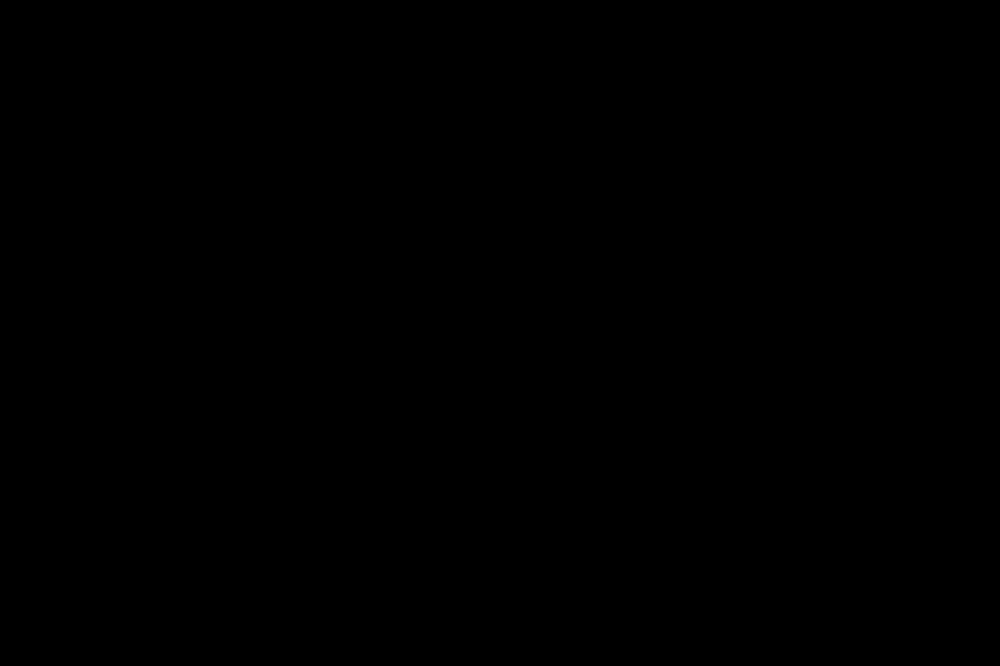

CPU times: user 1.14 s, sys: 250 ms, total: 1.39 s
Wall time: 1.37 s
storing in ../SharedData/scan-1851/promap-301/
load scan-1854
List images, loading and pre-processing now
Pre-processing finished
Horizontal count: 11
Vertical count: 13
CPU times: user 2.08 s, sys: 4.41 s, total: 6.49 s
Wall time: 1min 48s
calculate diff
run pack
build promap


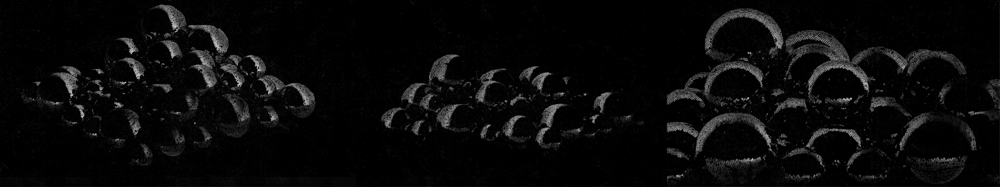

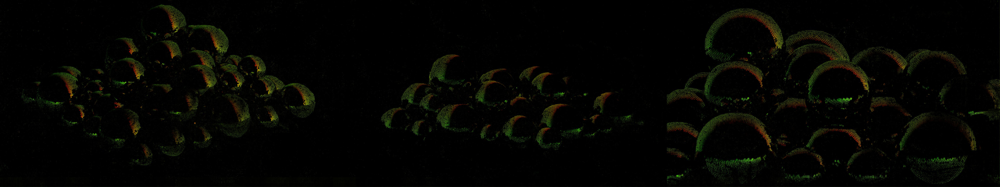

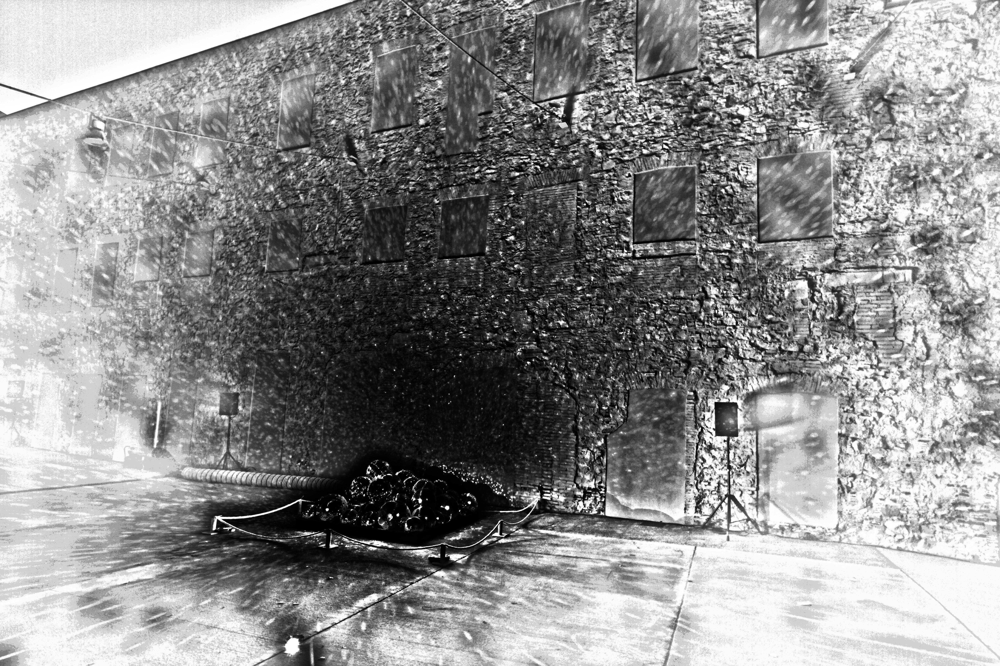

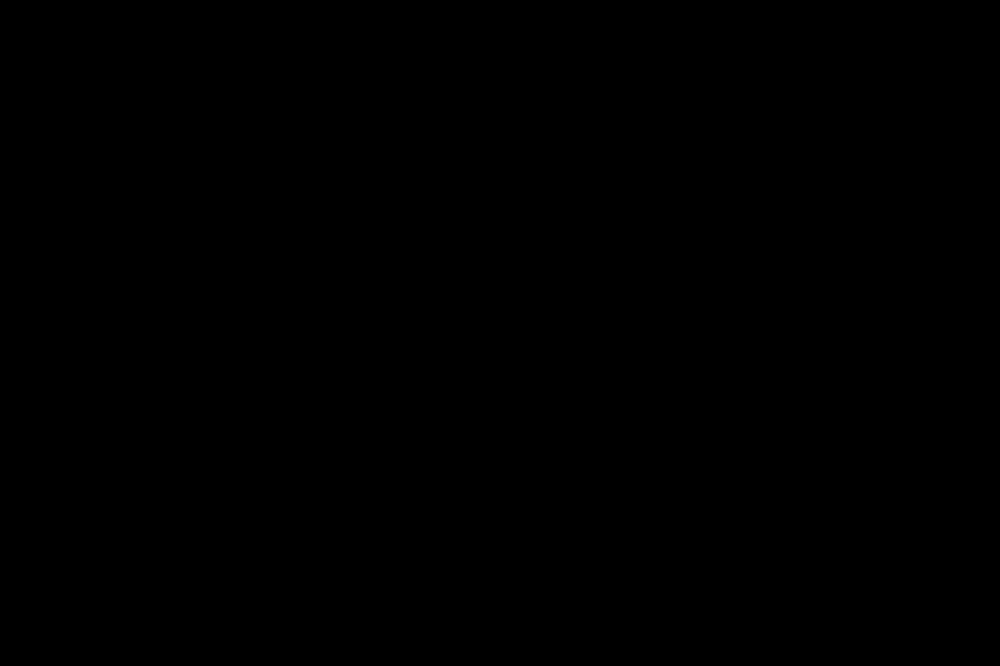

CPU times: user 1.16 s, sys: 290 ms, total: 1.45 s
Wall time: 1.41 s
storing in ../SharedData/scan-1854/promap-301/
load scan-1858
List images, loading and pre-processing now
Pre-processing finished
Horizontal count: 11
Vertical count: 13
CPU times: user 2.15 s, sys: 4.63 s, total: 6.78 s
Wall time: 1min 50s
calculate diff
run pack
build promap


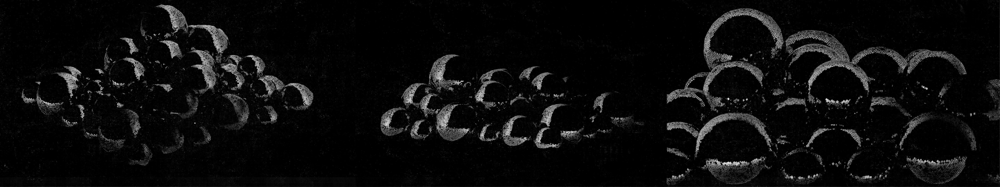

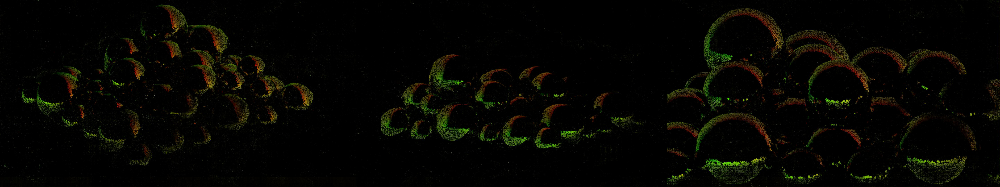

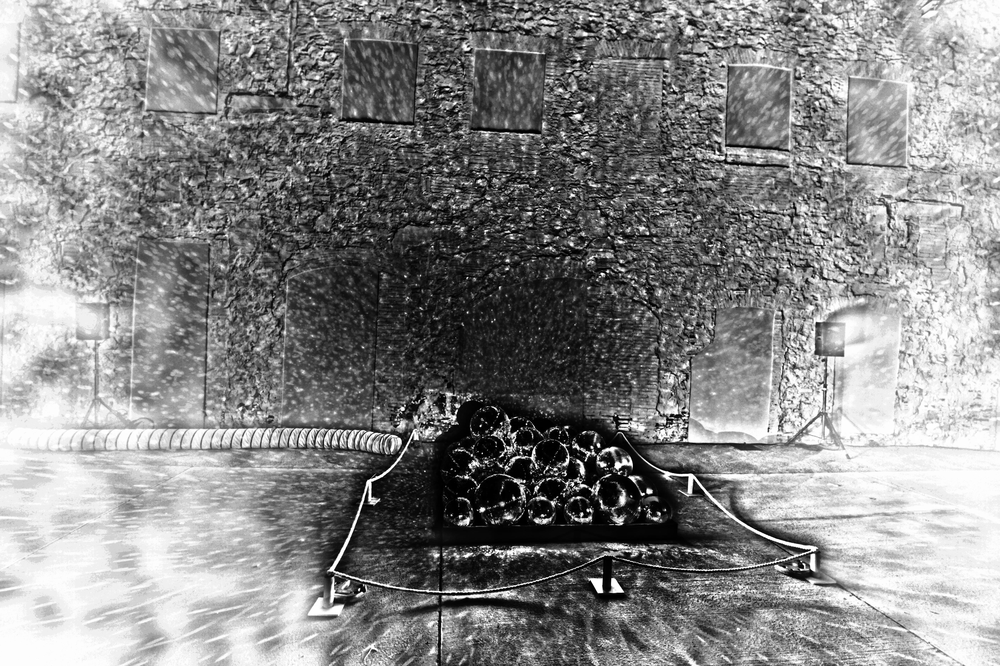

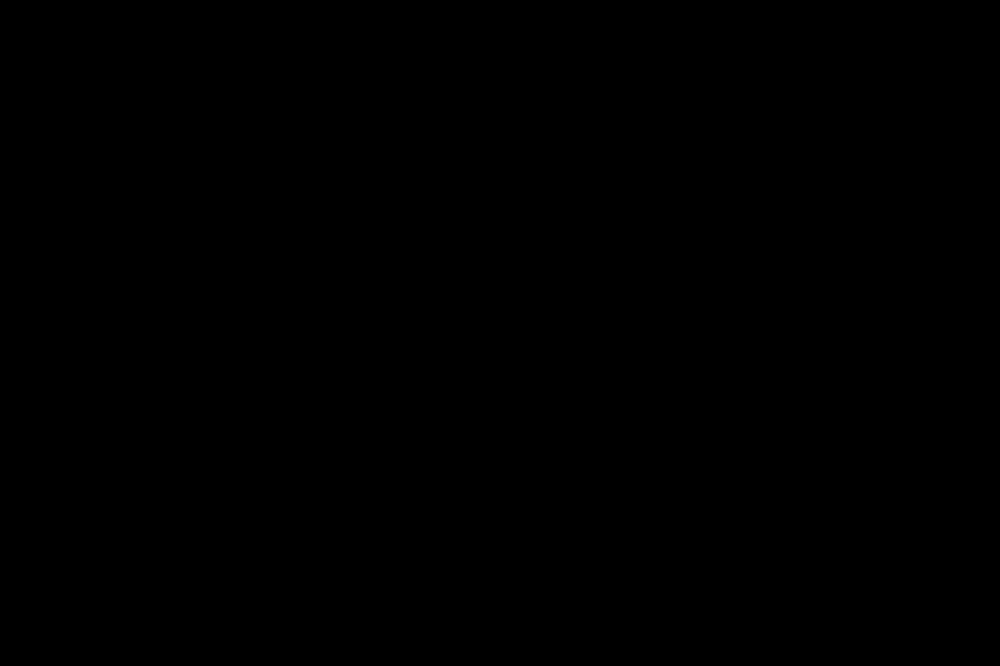

CPU times: user 1.09 s, sys: 370 ms, total: 1.46 s
Wall time: 1.42 s
storing in ../SharedData/scan-1858/promap-301/


In [15]:
import re
folders = sorted([f for f in os.listdir(data_dir) if re.match(r'^scan-18', f)])
print(folders)
# folders = folders[5:] 
# folders = [folders[0]]
print(folders)
# asdasd
for folder in folders:
    if not exists(folder):
        try:
            print('load '+folder)
            %time load_scan(folder)
            print('calculate diff')
            calculate_difference()
            print('run pack')
            run_pack()
            print('build promap')
            run_build_promap()
            %time render_result()
            store_results(folder)
        except Exception as e: 
            print("Had to cancel ",folder)
            print(e)
    else: 
        print("Skipping %s since its already processed" % folder)

In [168]:
%matplotlib inline


sync_data()
# #Download data
# procams_folder = '/tmp/procams/'
# # !rm -rf {procams_folder}
# !mkdir -p {procams_folder}
# # !gsutil -m cp -r gs://{bucket}/processedScans/* {procams_folder}
# !gsutil -m rsync -r gs://{bucket}/ {procams_folder}
!ls {data_dir}

Building synchronization state...
Starting synchronization...
BuildXYZDebug.png    model.dae	scan-1512  scan-1529  settings.json
confidenceMap-0.exr  scan-1249	scan-1515  scan-1534  shader
_mask-0.png	     scan-1255	scan-1521  scan-1539  SharedData
mask-0.png	     scan-1338	scan-1524  scan-1541  xyzMap-0.exr
